This notebook demonstrates some visualizations of the trees. We use the library igraph for this. Note that the only library the core algorithm needs is numpy. Any other library used here is simply for visualization or data generation purposes. 

# Imports

In [1]:
%matplotlib inline
import sys
import igraph as ig
import matplotlib.pyplot as plt
import numpy as np
import random as rn
import eif as iso
import copy
import seaborn as sb
sb.set_style(style="whitegrid")
sb.set_color_codes()
ig.__version__

'0.7.1'

# Utility Functions

In [2]:
def branch2num(branch, init_root=0):
    num = [init_root]
    for b in branch:
        if b == 'L':
            num.append(num[-1] * 2 + 1)
        if b == 'R':
            num.append(num[-1] * 2 + 2)
    return num

In [3]:
def gen_graph(branches, g = None, init_root = 0, pre = ''):
    num_branches = [branch2num(i, init_root) for i in branches]
    all_nodes = [j for branch in num_branches for j in branch]
    all_nodes = np.unique(all_nodes)
    all_nodes = all_nodes.tolist()
    if g is None:
        g=ig.Graph()
    for k in all_nodes : g.add_vertex(pre+str(k))
    t=[]
    for j in range(len(branches)):
        branch = branch2num(branches[j], init_root)
        for i in range(len(branch)-1):
            pair = [branch[i],branch[i+1]]
            if pair not in t:
                t.append(pair)
                g.add_edge(pre+str(branch[i]),pre+str(branch[i+1]))
    return g,max(all_nodes)

## Making fake data 

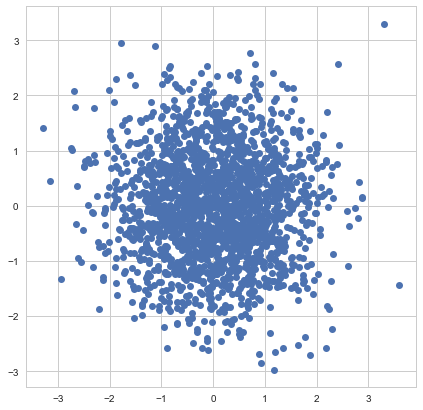

In [4]:
mean = [0, 0]
cov = [[1, 0], [0, 1]]  # diagonal covariance
Nobjs = 2000
x, y = np.random.multivariate_normal(mean, cov, Nobjs).T
#Add manual outlier
x[0]=3.3
y[0]=3.3
X=np.array([x,y]).T
plt.figure(figsize=(7,7))
plt.plot(x,y,'bo')

## Creating Forest (200 trees)

In [5]:
F = iso.iForest(X,ntrees=200, sample_size=256)

## Computing path for all data points

In [6]:
S=F.compute_paths(X_in=X)
ss=np.argsort(S)

## Plotting 1 of the trees in the forest

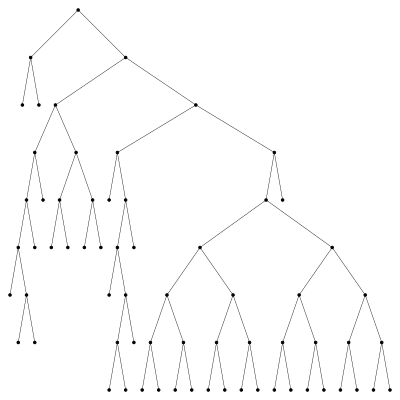

In [7]:
n_v = [0]
n_e = []
jt=0
T=F.Trees[jt]
gg,nn=gen_graph(iso.all_branches(T.root,[],None,),None,0,'0_')
n_v.append(gg.vcount())
n_e.append(gg.ecount())
vstyle={}
vstyle["vertex_size"]=[2.5]*gg.vcount()
vstyle["vertex_color"]=['black']*gg.vcount()
#vstyle["vertex_label"]=g.vs['name']
vstyle["vertex_label_dist"]=2
vstyle["bbox"] = (400, 400)
vstyle["edge_color"]= [(0,0.,0.)]*gg.ecount()
vstyle["edge_width"] = [0.4]*gg.ecount()
vstyle["layout"]=gg.layout_reingold_tilford(root=[0])
vstyle["edge_curved"]=0.00
vstyle["margin"]=10
ig.plot(gg,**vstyle)

### Overplot the path for one anomaly in same tree

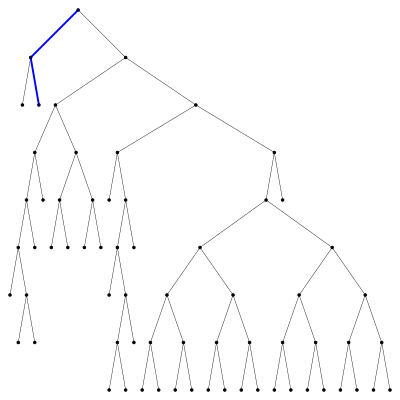

In [8]:
P=iso.PathFactor(X[ss[-1]],T)
Gn=branch2num(P.path_list)
lb=gg.get_shortest_paths('0_'+str(Gn[0]), '0_'+str(Gn[-1]))[0]
le=gg.get_eids([(lb[i],lb[i+1]) for i in range(len(lb)-1)])
vstyle2 = copy.deepcopy(vstyle)
for j in le: 
    vstyle2["edge_color"][j]= 'blue'
    vstyle2["edge_width"][j] = 1.9
for v in lb:
    vstyle2["vertex_color"][v]='blue'
ig.plot(gg,**vstyle2)

## Plotting first 100 trees (radially)

In [10]:
for kt in range(1,100):
    T=F.Trees[kt]
    gg,nn=gen_graph(iso.all_branches(T.root,[],None,),gg,0,str(kt)+'_')
    n_v.append(gg.vcount())
    n_e.append(gg.ecount())

In [11]:
vstyle={}
vstyle["vertex_size"]=[.01]*gg.vcount()
vstyle["vertex_color"]=['black']*gg.vcount()
#vstyle["vertex_label"]=g.vs['name']
vstyle["vertex_label_dist"]=2
vstyle["bbox"] = (700, 700)
vstyle["edge_color"]= [(0,0.,0.)]*gg.ecount()
vstyle["edge_width"] = [0.05]*gg.ecount()
vstyle["layout"]=gg.layout_reingold_tilford_circular(root=n_v)
vstyle["edge_curved"]=0.00
vstyle["margin"]=10
ig.plot(gg,**vstyle)

## Overplotting the path for one anomaly

In [13]:
vstyle2 = copy.deepcopy(vstyle)
for kt in range(0,100):
    T=F.Trees[kt]
    pre=str(kt)+'_'
    P=iso.PathFactor(X[ss[-1]],T)
    Gn=branch2num(P.path_list)
    lb=gg.get_shortest_paths(pre+str(Gn[0]), pre+str(Gn[-1]))[0]
    le=gg.get_eids([(lb[i],lb[i+1]) for i in range(len(lb)-1)])
    for j in le: 
        vstyle2["edge_color"][j]= 'red'
        vstyle2["edge_width"][j] = 1.0
ig.plot(gg,**vstyle2)

## Overplotting the path for one non anomaly

In [14]:
vstyle2 = copy.deepcopy(vstyle)
for kt in range(0,100):
    T=F.Trees[kt]
    pre=str(kt)+'_'
    P=iso.PathFactor(X[ss[0]],T)
    Gn=branch2num(P.path_list)
    lb=gg.get_shortest_paths(pre+str(Gn[0]), pre+str(Gn[-1]))[0]
    le=gg.get_eids([(lb[i],lb[i+1]) for i in range(len(lb)-1)])
    for j in le: 
        vstyle2["edge_color"][j]= 'blue'
        vstyle2["edge_width"][j] = 1.0
ig.plot(gg,**vstyle2)